In [34]:
import numpy as np
import cv2
from matplotlib import pyplot as plt
import math

In [35]:
def printImage(image):
    plt.figure(figsize = (10, 10))
    plt.imshow(image, 'gray')

In [36]:
def shiftImage(image):
    image_shape = image.shape
    result = np.zeros(image_shape)
    for x in range(image_shape[0]):
        for y in range(image_shape[1]):
            result[x, y] = image[x, y] * (-1)**(x+y)
    return result

In [37]:
def asap_rocky_function(image1, image2, image3, image4):
    plt.figure(figsize = (120, 120))
    plt.subplot(10, 10, 1)
    plt.imshow(image1)
    plt.subplot(10, 10, 2)
    plt.imshow(image2)
    plt.subplot(10, 10, 3)
    plt.imshow(image3)
    plt.subplot(10, 10, 4)
    plt.imshow(image4)
    plt.show()

In [38]:
source_image = cv2.imread("TestImage4.jpg", 0)
source_shape = source_image.shape
print(source_shape)

(894, 894)


In [39]:
#                   numpy фурье + РУЧНОЙ СДВИГ
#spectrum_without_shift = np.fft.fft2(source_image)
#spectrum_without_shift_log = np.log(np.abs(spectrum_without_shift))

#spectrum_with_shift = np.fft.fft2(shiftImage(source_image))
#spectrum_with_shift_log = np.log(np.abs(spectrum_with_shift))

In [50]:
#                   numpy фурье + NUMPY СДВИГ  
f = np.fft.fft2(source_image)

spectrum_with_shift = np.fft.fftshift(f)
spectrum_with_shift_log = 20*np.log(np.abs(spectrum_with_shift))

spectrum_without_shift = f
spectrum_without_shift_log = 20*np.log(np.abs(spectrum_without_shift))

In [51]:
#                           OpenCV 
#dft = cv2.dft(np.float32(source_image),flags = cv2.DFT_COMPLEX_OUTPUT)
#spectrum_without_shift = dft
#spectrum_without_shift_log = 20*np.log(cv2.magnitude(spectrum_without_shift[:,:,0],spectrum_without_shift[:,:,1]))

#spectrum_with_shift = np.fft.fftshift(dft)
#spectrum_with_shift_log = 20*np.log(cv2.magnitude(spectrum_with_shift[:,:,0],spectrum_with_shift[:,:,1]))

(894, 894)


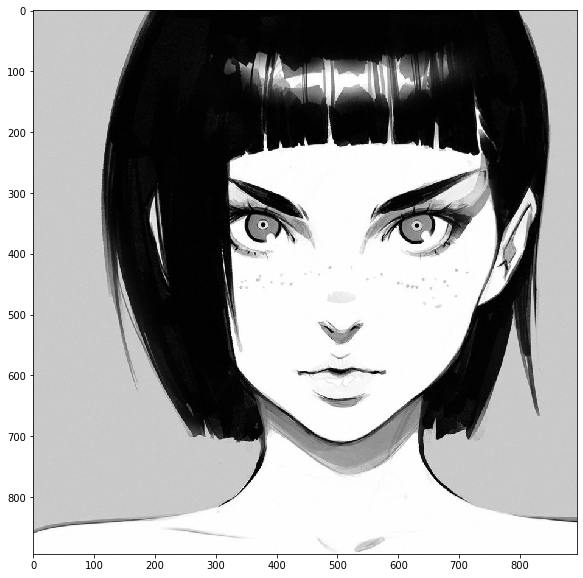

In [52]:
print(source_image.shape)
printImage(source_image)

(894, 894)


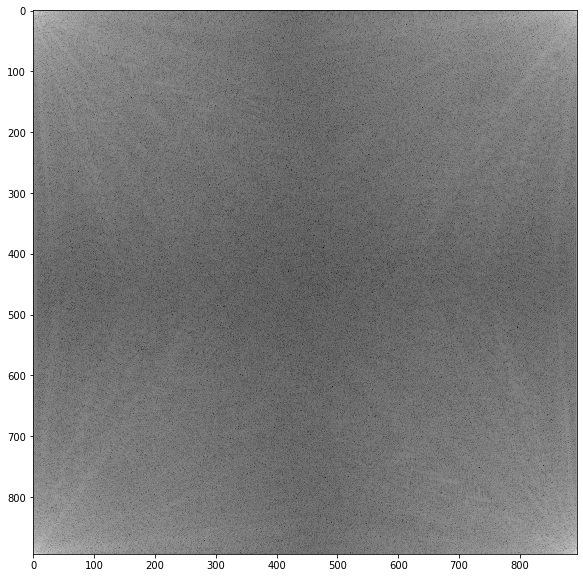

In [53]:
print(spectrum_without_shift.shape)
printImage(spectrum_without_shift_log)

(894, 894)


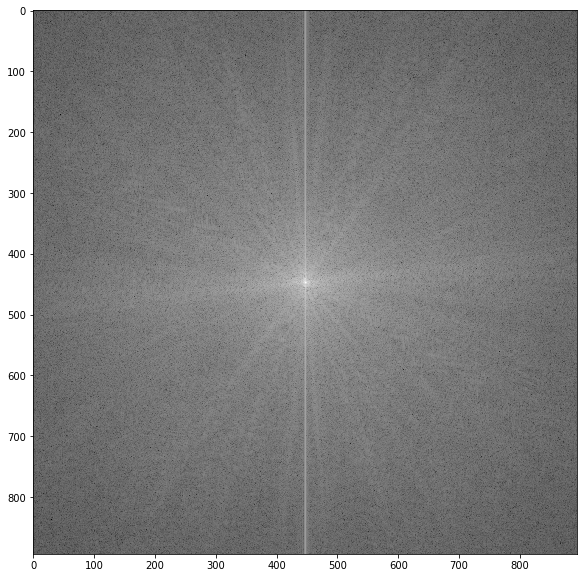

In [54]:
print(spectrum_with_shift.shape)
printImage(spectrum_with_shift_log)

In [55]:
diameter = 100

Структурный элемент для идеального фильтра
(100, 100)


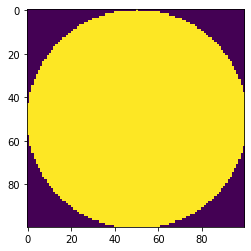

In [56]:
#низкие частоты
circle = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (diameter, diameter))
print("Структурный элемент для идеального фильтра")
plt.imshow(circle);
print(circle.shape)


(894, 894)


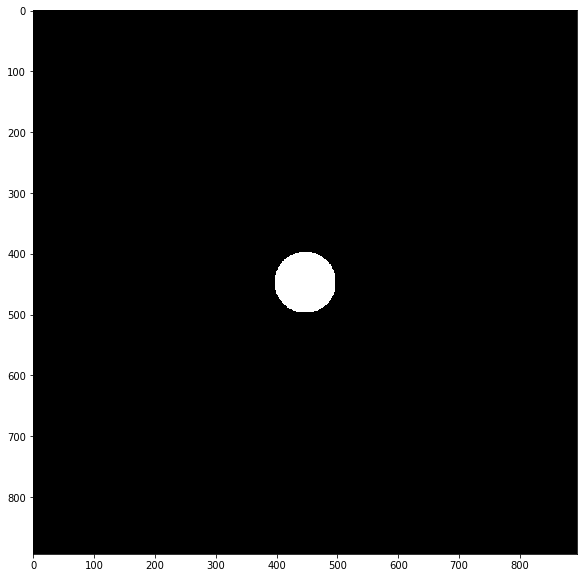

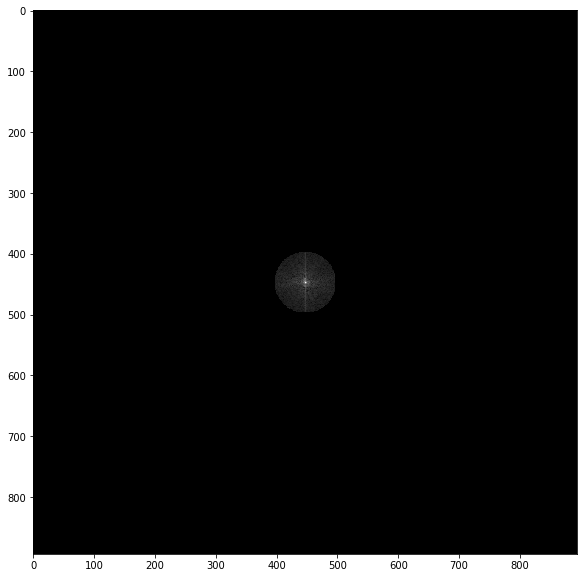

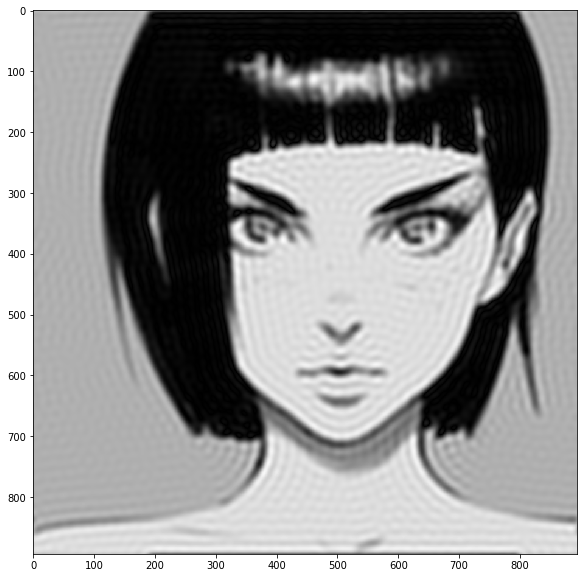

In [57]:
x = int(source_shape[0] / 2 - diameter / 2)
y = int(source_shape[1] / 2 - diameter / 2)
ideal_filter_low = np.zeros(source_shape)
for i in range(diameter):
    for j in range(diameter):
        ideal_filter_low[x + i, y + j] = ideal_filter_low[x + i, y + j] + circle[i, j]
print(ideal_filter_low.shape)
printImage(ideal_filter_low)

f = ideal_filter_low * spectrum_with_shift

spectrum_f_low = np.power(np.abs(f), 0.3)
#spectrum_f = np.log(np.abs(f))
printImage(spectrum_f_low)
result = np.abs(np.fft.ifft2(f))
printImage(result)

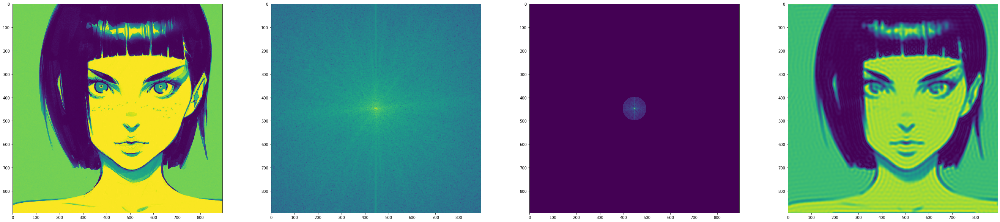

In [58]:
asap_rocky_function(source_image, spectrum_with_shift_log, spectrum_f_low, result)

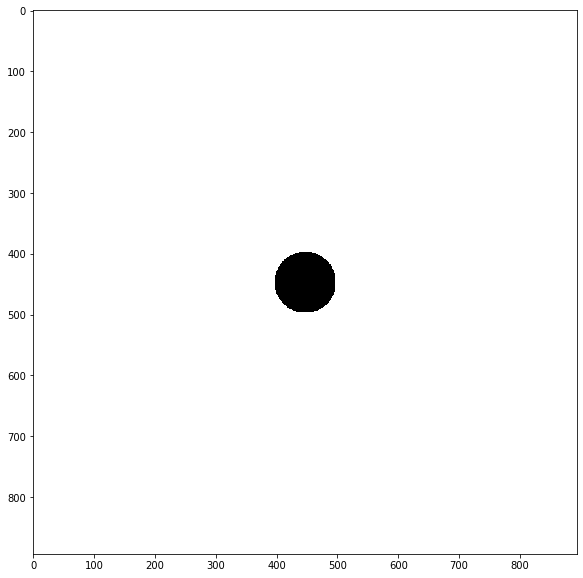

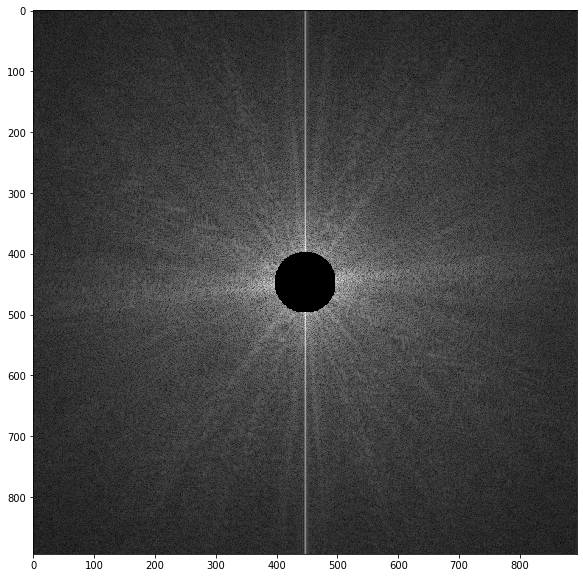

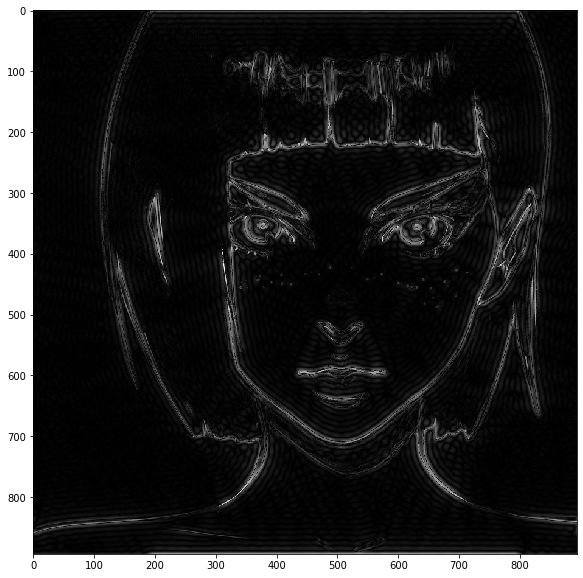

In [17]:
#высокие частоты
ideal_filter_h = np.ones(source_shape) - ideal_filter_low
#ideal_filter_h = (255 - ideal_filter_low)
printImage(ideal_filter_h)
f = ideal_filter_h * spectrum_with_shift
spectrum_f_high = np.power(np.abs(f), 0.3)
printImage(spectrum_f_high)
result_fh = np.abs(np.fft.ifft2(f))
printImage(result_fh)

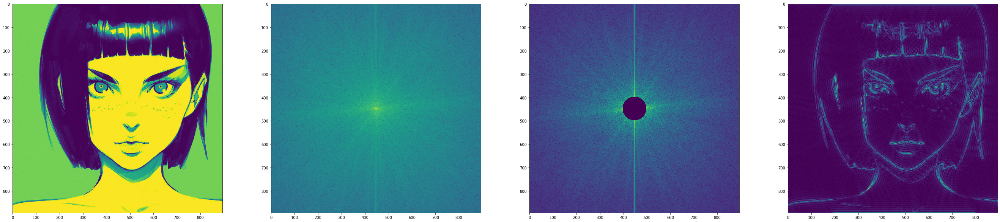

In [18]:
asap_rocky_function(source_image, spectrum_with_shift_log, spectrum_f_high, result_fh)

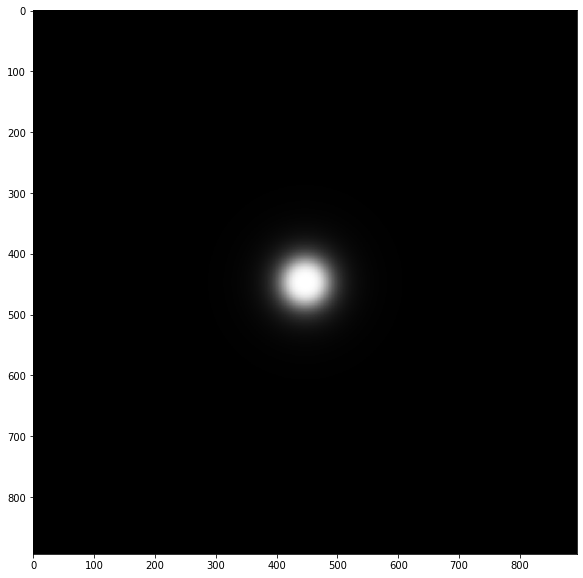

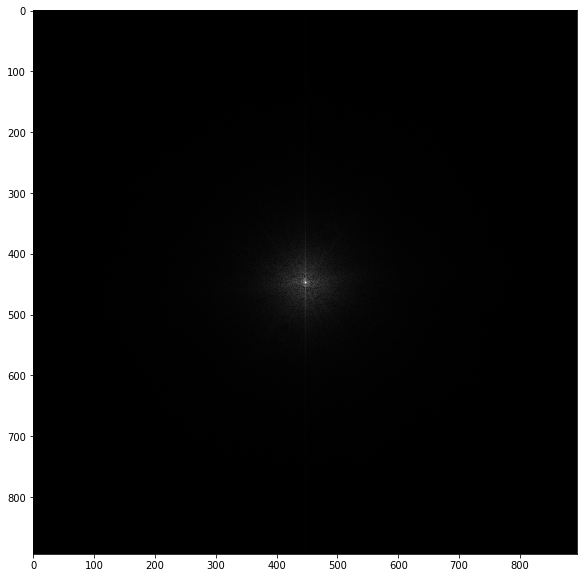

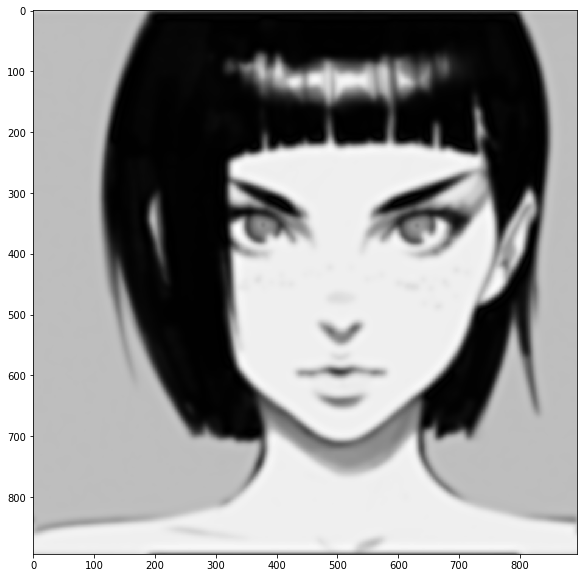

In [19]:
coef_size = 40
coef_blurry = 2
filter_butter_low = np.zeros(source_shape)
for i in range(source_shape[0]):
    for j in range(source_shape[1]):
        temp = math.sqrt((i - source_shape[0] / 2) ** 2 + (j - source_shape[1] / 2) ** 2)
        filter_butter_low[i, j] = 1 / (1 + (temp / coef_size) ** (2 * coef_blurry))
printImage(filter_butter_low)
spectrum_butter_low = spectrum_with_shift * filter_butter_low
spectrum_butter_low_power = np.power(np.abs(spectrum_butter_low), 0.3)
printImage(spectrum_butter_low_power)
result_butter_low = np.abs(np.fft.ifft2(spectrum_butter_low))
printImage(result_butter_low)

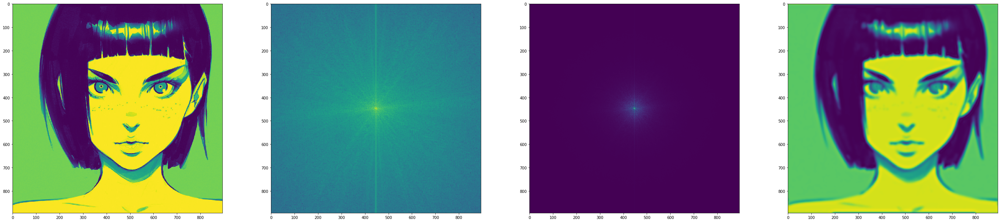

In [20]:
asap_rocky_function(source_image, spectrum_with_shift_log, spectrum_butter_low_power, result_butter_low)

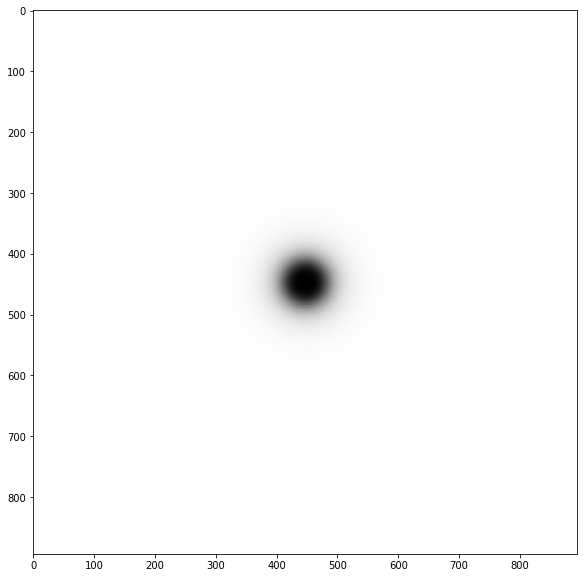

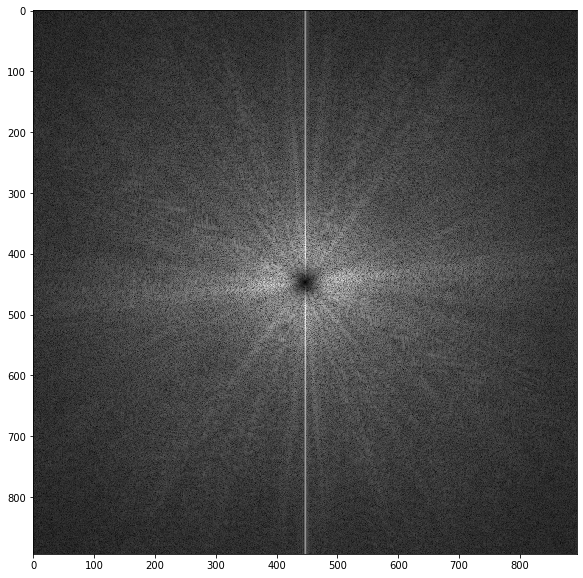

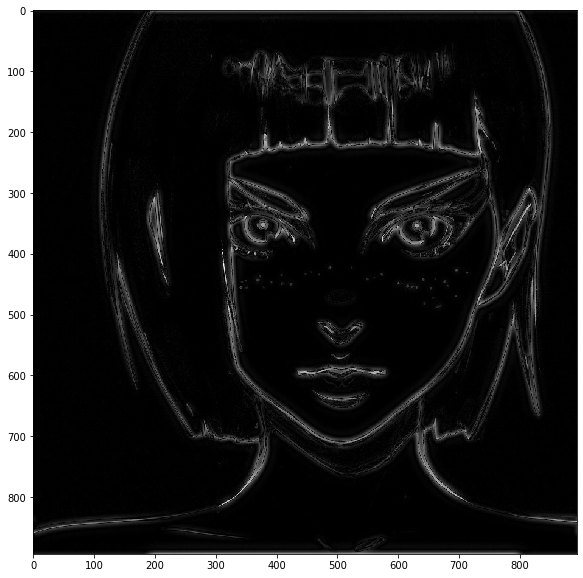

In [21]:
filter_butter_high = np.zeros(source_shape)
for i in range(source_shape[0]):
    for j in range(source_shape[1]):
        temp = math.sqrt((i - source_shape[0] / 2) ** 2 + (j - source_shape[1] / 2) ** 2)
        if temp != 0: 
            filter_butter_high[i, j] = 1 / (1 + (coef_size /temp ) ** (2 * coef_blurry))
            
printImage(filter_butter_high)
spectrum_filter_butter_high = filter_butter_high * spectrum_with_shift
spectrum_filter_butter_high_power = np.power(np.abs(spectrum_filter_butter_high), 0.3)
printImage(spectrum_filter_butter_high_power)
result_filter_butter_high = np.abs(np.fft.ifft2(spectrum_filter_butter_high))
printImage(result_filter_butter_high)

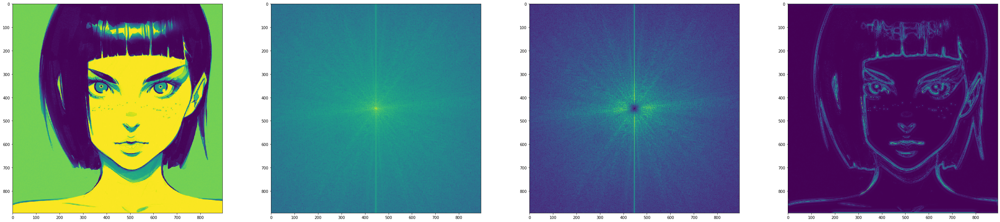

In [22]:
asap_rocky_function(source_image, spectrum_with_shift_log,
                    spectrum_filter_butter_high_power, result_filter_butter_high)

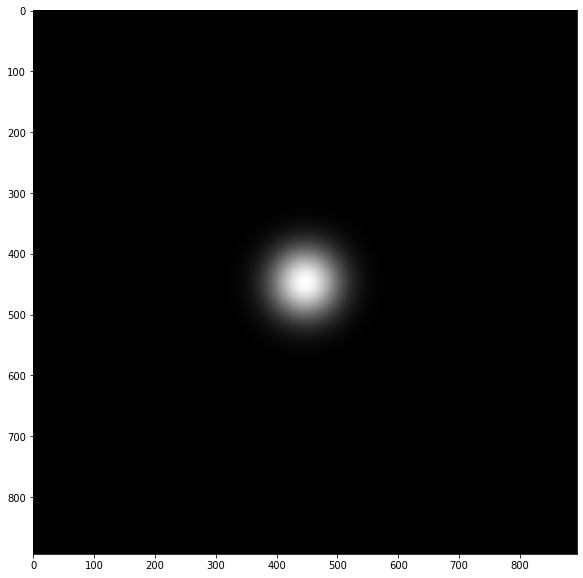

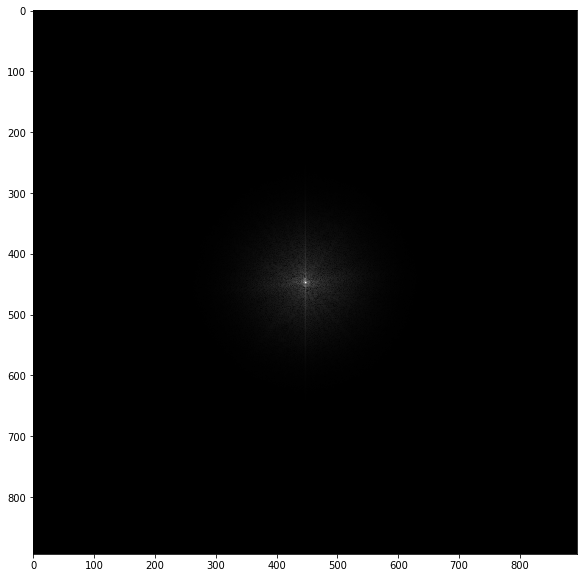

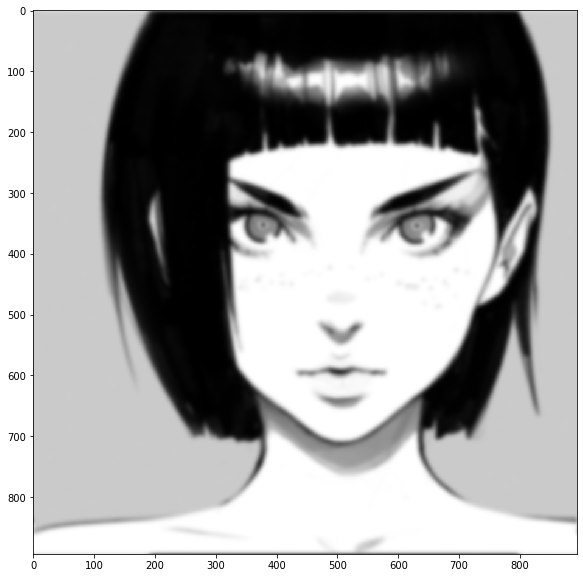

In [23]:
gaus_filter_low = np.zeros(source_shape)
for i in range(source_shape[0]):
    for j in range(source_shape[1]): 
        temp = math.sqrt((i - source_shape[0] / 2) ** 2 + (j - source_shape[1] / 2) ** 2)
        gaus_filter_low[i, j] = math.exp((-1) * (temp ** 2) / (2 * coef_size ** 2))
printImage(gaus_filter_low)
spectrum_gaus_filter_low = spectrum_with_shift * gaus_filter_low
spectrum_gaus_filter_low_power = np.power(np.abs(spectrum_gaus_filter_low), 0.3)
printImage(spectrum_gaus_filter_low_power)
result_gaus_filter_low = np.abs(np.fft.ifft2(spectrum_gaus_filter_low))
printImage(result_gaus_filter_low)

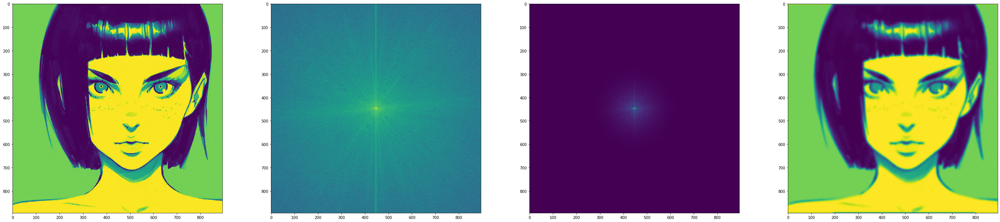

In [24]:
asap_rocky_function(source_image, spectrum_with_shift_log, spectrum_gaus_filter_low_power, result_gaus_filter_low)

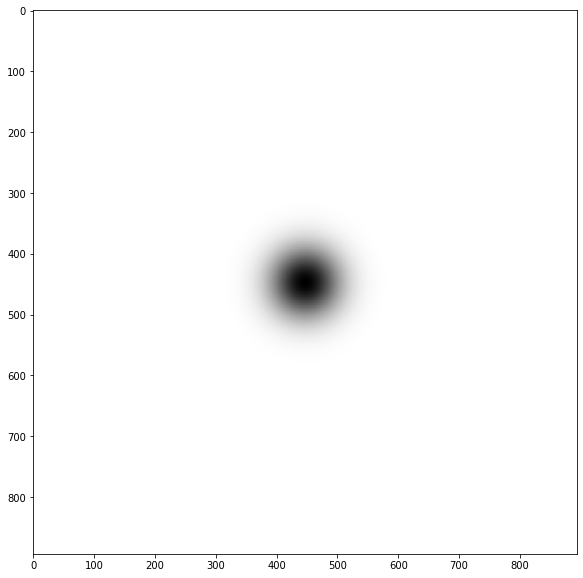

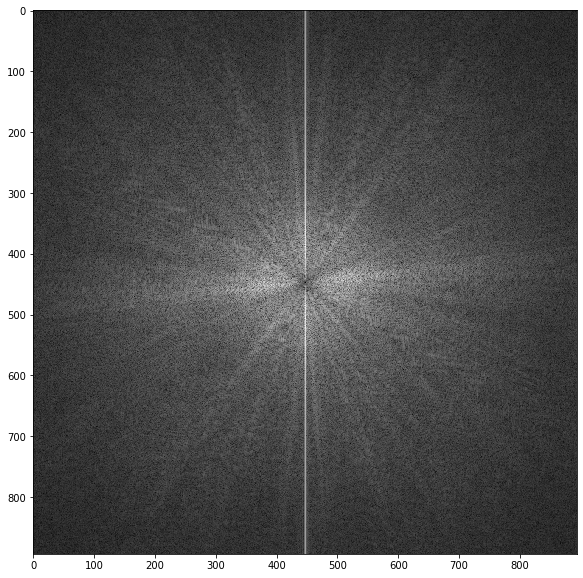

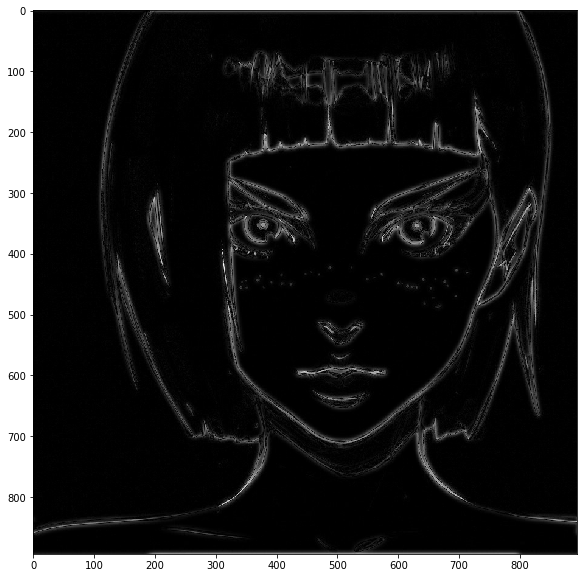

In [25]:
gaus_filter_high = np.zeros(source_shape)
for i in range(source_shape[0]):
    for j in range(source_shape[1]):        
        temp = math.sqrt((i - source_shape[0] / 2) ** 2 + (j - source_shape[1] / 2) ** 2)
        gaus_filter_high[i, j] = 1 - math.exp((-1) * (temp ** 2) / (2 * coef_size ** 2))
printImage(gaus_filter_high)
spectrum_gaus_filter_high = gaus_filter_high * spectrum_with_shift
spectrum_gaus_filter_high_power = np.power(np.abs(spectrum_gaus_filter_high), 0.3)
printImage(spectrum_gaus_filter_high_power)
result_gaus_filter_high = np.abs(np.fft.ifft2(spectrum_gaus_filter_high))
printImage(result_gaus_filter_high)


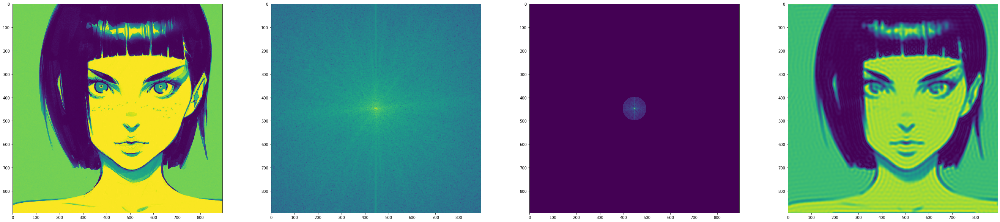

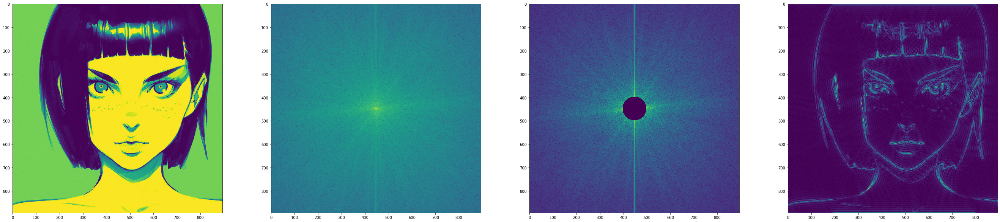

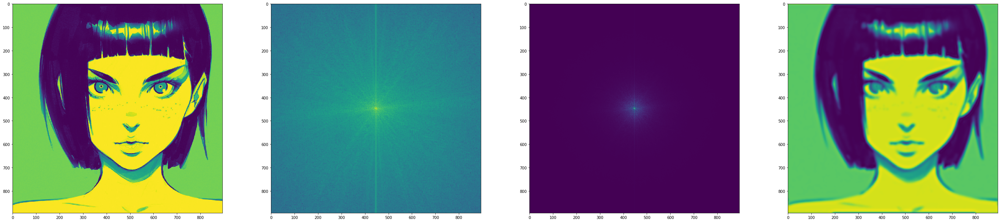

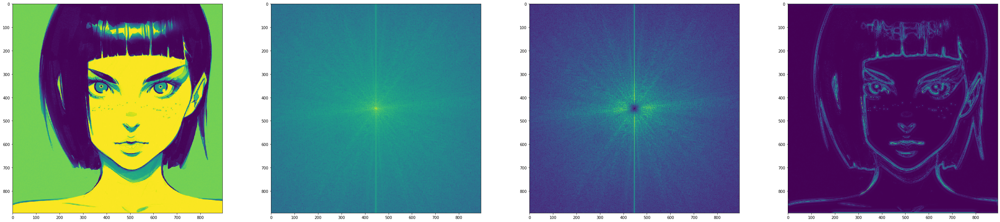

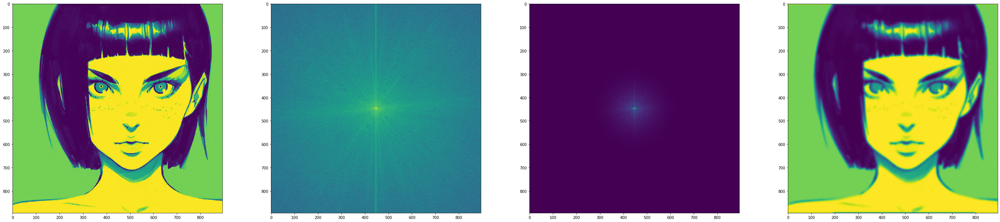

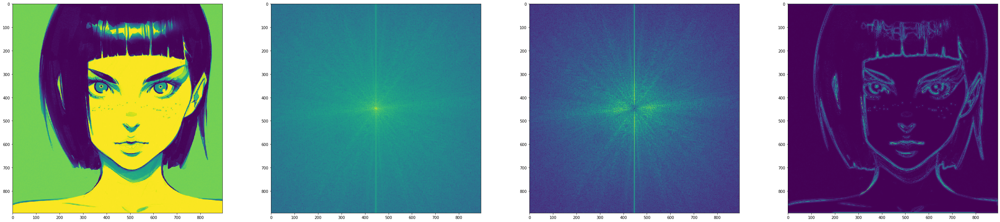

In [26]:
asap_rocky_function(source_image, spectrum_with_shift_log, spectrum_f_low, result)
asap_rocky_function(source_image, spectrum_with_shift_log, spectrum_f_high, result_fh)

asap_rocky_function(source_image, spectrum_with_shift_log, spectrum_butter_low_power, result_butter_low)
asap_rocky_function(source_image, spectrum_with_shift_log, 
                    spectrum_filter_butter_high_power, result_filter_butter_high)

asap_rocky_function(source_image, spectrum_with_shift_log, spectrum_gaus_filter_low_power, result_gaus_filter_low)
asap_rocky_function(source_image, spectrum_with_shift_log, spectrum_gaus_filter_high_power, result_gaus_filter_high)